Importing the image

In [1]:
!pip install pillow requests

In [2]:
from PIL import Image
import requests
from io import BytesIO
from IPython.display import display
import numpy as np
import matplotlib.pyplot as plt

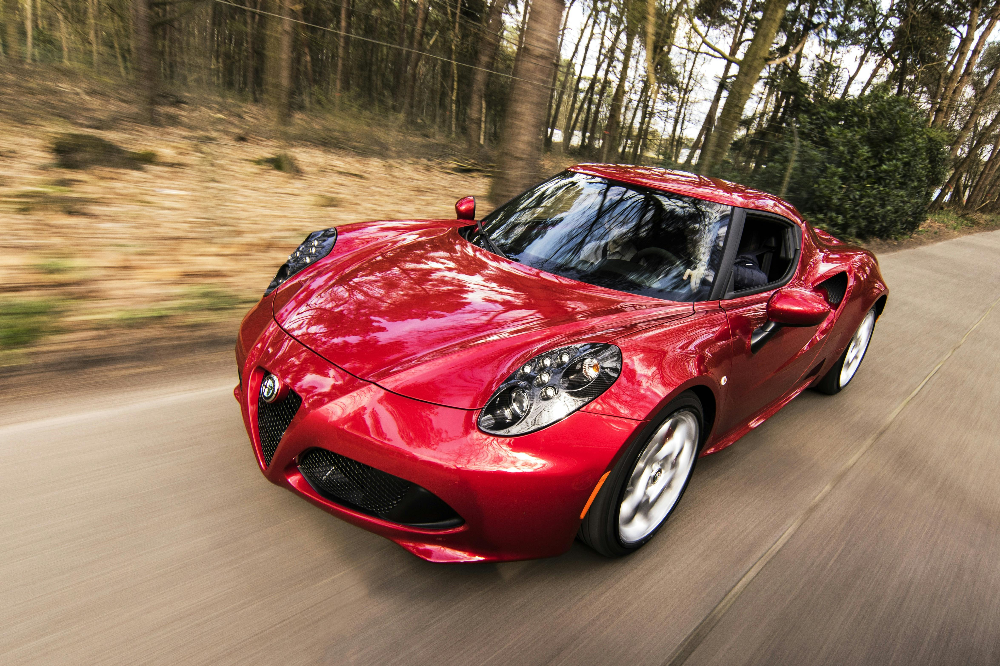

In [3]:
# my_url = "https://ia803106.us.archive.org/27/items/WindowsVista.InboxMedium.Photo/Autumn%20Leaves.jpg"
my_url = "https://images.pexels.com/photos/210019/pexels-photo-210019.jpeg"
my_res = requests.get(my_url)
my_img = Image.open(BytesIO(my_res.content))

# Display image inline in Kaggle, Colab, Jupyter
display(my_img)


The 3 equations governing the hyperchaotic behaviour

$$ x_{n+1} = a_1x_{n} + a_2y_{n} + a_3y_{n}^2 $$

$$ y_{n+1} = b_1 - b_2z_n $$

$$ z = cx_{n} $$

The above equations can be used to generate chaotic patterns

For encryption we can 3 operations in sequence
 
$$ \text{XOR operation- } E_{i,j} = P_{i,j} XOR (X_{i,j}.255) $$


$$ \text{Addition operation- } E_{i,j} = (P_{i,j}  + (Y_{i,j).255) mod 256$$


$$ \text{Subraction operation- } E_{i,j} = (P_{i,j} - (Z_{i,j}.255)) mod 256$$

In [ ]:
#function for encryption
#Initial values for ensuring that equations map the hyperchaotic behaviour

a1,a2,a3 = 0.03, 0.25,0.11
b1,b2 = 4,1.2
c = 2.15


#Function for normalisation
def chaos_normalisation(seq):
    mn, mx = seq.min(), seq.max()
    return (seq-mn) / (mx - mn + 1e-12)


#Function for encryption
def encrypt(image : np.array):
    height, width = image.shape
    size = height * width
    x_seq = np.zeros(size)
    y_seq = np.zeros(size)
    z_seq = np.zeros(size)

    #Initial values of x,y,z
    x,y,z = 0.1,0.1,0.1


    for step in range(size):
        x_new = a1 * x + a2 * y + a3 * (y * y)
        y_new = b1 - b2 * z
        z_new = c * x
        x_seq[step] = x_new
        y_seq[step] = y_new
        z_seq[step] = z_new
        x,y,z = x_new, y_new, z_new

    x_seq = chaos_normalisation(x_seq).reshape((height,width))
    y_seq = chaos_normalisation(y_seq).reshape((height,width))
    z_seq = chaos_normalisation(z_seq).reshape((height,width))

    encrypted = image.copy().astype(np.uint8)

    #step 1
    encrypted = encrypted ^ np.floor(x_seq * 255).astype(np.uint8)

    #step 2
    encrypted = (encrypted + np.floor(y_seq * 255)).astype(np.uint8) % 256

    #step 3
    encrypted = (encrypted - np.floor(z_seq * 255)).astype(np.uint8) % 256

    return encrypted

    
    

So approach that I am following is that I will encrypt the R,G,B band seperately and then at the end stack them together to obtain the RGB encrypted image.

In [ ]:
def encrypt_RGB(image):
    img = np.array(image)
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]

    R_encrypted = encrypt(R)
    G_encrypted = encrypt(G)
    B_encrypted = encrypt(B)

    encrypted_RGB = np.stack([R_encrypted, G_encrypted, B_encrypted], axis = 2)

    return encrypted_RGB

In [ ]:
enc_img = encrypt_RGB(my_img)

In [ ]:
plt.imshow(enc_img)
plt.axis('off')
plt.show()

Decryption algorithm is an exact reverse of the encryption algorithm

In [ ]:
def decrypt(enc_image:np.array):
    height, width = enc_image.shape
    size = height * width

    x_seq = np.zeros(size)
    y_seq = np.zeros(size)
    z_seq = np.zeros(size)

    #Initial values of x,y,z
    x,y,z = 0.1,0.1,0.1

    for step in range(size):
        x_new = a1 * x + a2 * y + a3 * (y * y)
        y_new = b1 - b2 * z
        z_new = c * x
        x_seq[step] = x_new
        y_seq[step] = y_new
        z_seq[step] = z_new
        x,y,z = x_new, y_new, z_new

    x_seq = chaos_normalisation(x_seq).reshape((height,width))
    y_seq = chaos_normalisation(y_seq).reshape((height,width))
    z_seq = chaos_normalisation(z_seq).reshape((height,width))

    decrypted = enc_image.copy().astype(np.uint8) 

    #step 1
    decrypted = (decrypted + np.floor(z_seq * 255)).astype(np.uint8) % 256

    #step 2
    decrypted = (decrypted - np.floor(y_seq * 255)).astype(np.uint8) % 256

    #step 3
    decrypted = decrypted ^ np.floor(x_seq * 255).astype(np.uint8)

    return decrypted

def decrypt_RGB(image:np.array):
    R = image[:,:,0]
    G = image[:,:,1]
    B = image[:,:,2]
    R_dec = decrypt(R)
    G_dec = decrypt(G)
    B_dec = decrypt(B)

    decrypted_RGB = np.stack([R_dec, G_dec, B_dec], axis = 2)

    return decrypted_RGB 


    

In [ ]:
dec_img = decrypt_RGB(enc_img)

In [ ]:
plt.imshow(dec_img)
plt.axis('off')
plt.show()

Here my observation is that large objects/ dominant structures remain partially discernible even after encryption using chaotic map.This occurs because the encryption process mainly scrambles pixel values but does not sufficiently disrupt global or large scale patterns, such as large objects presence affecting overall pixel distribution.

So the solutions:
1)Using pixel based permutation scrambling methods combined with chaotic value encryption
2)Using multiple rounds in encryption.

Building over the previous encryption function


Steps:-

1)generate the chaotic sequence as before

2)Perform the pixel value encryption using XOR,addition and subraction

3)Flatten the encrypted image to a 1D array

4)Generate the permutation vector from one of the normalized chaotic sequences.

5)Apply the permutation vector to the flattended encrypted pixels

6)reshape back to original dimensions

7)Repeat for multiple rounds

In [10]:
#function for encryption
#Initial values for ensuring that equations map the hyperchaotic behaviour

a1,a2,a3 = 0.03, 0.25,0.11
b1,b2 = 4,1.2
c = 2.15


#Function for normalisation
def chaos_normalisation(seq):
    mn, mx = seq.min(), seq.max()
    return (seq-mn) / (mx - mn + 1e-12)

def generate_permutation_vector(chaotic_sequence):
    permutation_vector = np.argsort(chaotic_sequence.flatten())
    return permutation_vector


#Function for encryption
def encrypt(image : np.array,rounds:int = 1):
    height, width = image.shape
    size = height * width
    

    for round in range(rounds):
        print(f"Round: {round}")
        x_seq = np.zeros(size)
        y_seq = np.zeros(size)
        z_seq = np.zeros(size)
    
        #Initial values of x,y,z
        x,y,z = 0.1,0.1,0.1

        for step in range(size):
            x_new = a1 * x + a2 * y + a3 * (y * y)
            y_new = b1 - b2 * z
            z_new = c * x
            x_seq[step] = x_new
            y_seq[step] = y_new
            z_seq[step] = z_new
            x,y,z = x_new, y_new, z_new

        x_seq = chaos_normalisation(x_seq).reshape((height,width))
        y_seq = chaos_normalisation(y_seq).reshape((height,width))
        z_seq = chaos_normalisation(z_seq).reshape((height,width))
    
        encrypted = image.copy().astype(np.uint8)
    
        #step 1
        encrypted = encrypted ^ np.floor(x_seq * 255).astype(np.uint8)
    
        #step 2
        encrypted = (encrypted + np.floor(y_seq * 255)).astype(np.uint8) % 256
    
        #step 3
        encrypted = (encrypted - np.floor(z_seq * 255)).astype(np.uint8) % 256

        flat_encrypted = encrypted.flatten()

        permutation_vector = generate_permutation_vector(x_seq)

        permuted_flat_enc = flat_encrypted[permutation_vector]

        encrypted = permuted_flat_enc.reshape((height,width))

    return encrypted, permutation_vector



def encrypt_RGB(image,rounds:int = 1):
    img = np.array(image)
    R = img[:,:,0]
    G = img[:,:,1]
    B = img[:,:,2]

    R_encrypted, R_permutation = encrypt(R,rounds)
    G_encrypted, G_permutation = encrypt(G,rounds)
    B_encrypted, B_permutation = encrypt(B,rounds)

    encrypted_RGB = np.stack([R_encrypted, G_encrypted, B_encrypted], axis = 2)

    return encrypted_RGB, R_permutation, G_permutation, B_permutation    

In [11]:
enc_img, R_perm, G_perm, B_perm = encrypt_RGB(my_img,rounds = 2)

Round: 0
Round: 1
Round: 0
Round: 1
Round: 0
Round: 1


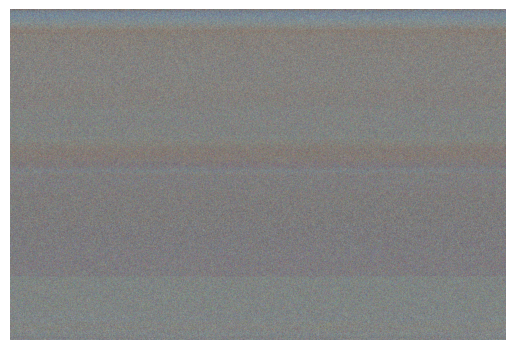

In [12]:
plt.imshow(enc_img)
plt.axis('off')
plt.show()

Decryption Code

In [13]:
def inverse_permutation(permutation_vector):
    inv_perm = np.empty_like(permutation_vector)
    inv_perm[permutation_vector] = np.arange(len(permutation_vector))
    return inv_perm.flatten()

def decrypt(enc_image:np.array,rounds:int,permutation_vector):
    height, width = enc_image.shape
    size = height * width

    for round in range(rounds):
        print(f"Round:{round}")
        x_seq = np.zeros(size)
        y_seq = np.zeros(size)
        z_seq = np.zeros(size)
    
        #Initial values of x,y,z
        x,y,z = 0.1,0.1,0.1
    
        for step in range(size):
            x_new = a1 * x + a2 * y + a3 * (y * y)
            y_new = b1 - b2 * z
            z_new = c * x
            x_seq[step] = x_new
            y_seq[step] = y_new
            z_seq[step] = z_new
            x,y,z = x_new, y_new, z_new
    
        x_seq = chaos_normalisation(x_seq).reshape((height,width))
        y_seq = chaos_normalisation(y_seq).reshape((height,width))
        z_seq = chaos_normalisation(z_seq).reshape((height,width))
    
        decrypted = enc_image.copy().astype(np.uint8)

        flat_decrypted = decrypted.flatten()
        inv_perm = inverse_permutation(permutation_vector)
        restored_flat_dec = flat_decrypted[inv_perm]

        decrypted = restored_flat_dec.reshape((height,width))
    
        #step 1
        decrypted = (decrypted + np.floor(z_seq * 255)).astype(np.uint8) % 256
    
        #step 2
        decrypted = (decrypted - np.floor(y_seq * 255)).astype(np.uint8) % 256
    
        #step 3
        decrypted = decrypted ^ np.floor(x_seq * 255).astype(np.uint8)

    return decrypted

def decrypt_RGB(image:np.array,rounds:int, R_perm, G_perm, B_perm):
    R = image[:,:,0]
    G = image[:,:,1]
    B = image[:,:,2]
    R_dec = decrypt(R,rounds,R_perm)
    G_dec = decrypt(G,rounds,G_perm)
    B_dec = decrypt(B,rounds,B_perm)

    decrypted_RGB = np.stack([R_dec, G_dec, B_dec], axis = 2)

    return decrypted_RGB 


    

In [14]:
dec_img = decrypt_RGB(enc_img,2, R_perm,G_perm, B_perm)

Round:0
Round:1
Round:0
Round:1
Round:0
Round:1


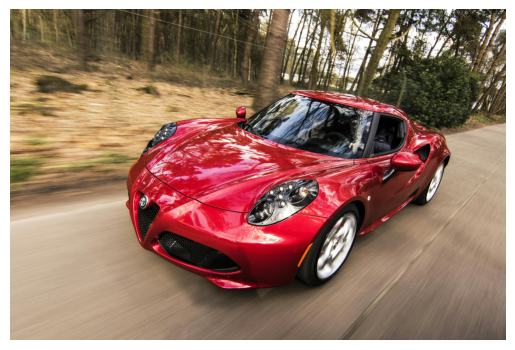

In [15]:
plt.imshow(dec_img)
plt.axis('off')
plt.show()

There are various ways of tuning the variables with values such that it leads to hyperchaotic 3d map system.

1)  Lyapunov Exponent Analysis

Fundamental requirement:-  For a system to be hyperchaotic, all Lyapunov exponents must be positive.

For this, for a given set of initial values, systematically varyoe or more parameters over a range.

2) Optimization using Genetic algorithms/particle swarm optimizations to search for sets of parameters(a1,a2,a3,b1,b2,c1)

So now using method 2 for generating different sets of values of {a1,a2,a3,b1,b2,c1}

In [16]:
import numpy as np
import random

In [ ]:
#defining the 3d hyperchaotic map
def hyperchaotic_map(params, steps = 10000):
    a1, a2, a3, b1, b2, c1 = params
    x , y, z = 0.1,0.1, 0.1
    xs , ys, zs = [], [], []
    for _ in range(steps):
        x_new = a1 * x + a2 * y + a3 * (y & y)
        y_new = b1 - b2 * z
        z_new = c1 * x
        xs.append(x_new)
        ys.append(y_new)
        zs.append(z_new)
        x, y, z = x_new, y_new, z_new
    return np.array(x_new), np.array(y_new), np.array(z_new)

